In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from __future__ import print_function
import keras
from keras.preprocessing.image import ImageDataGenerator, load_img

/home/ubuntu/.pyenv/versions/3.5.5/envs/recycle/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
train_dir = './clean-dataset/train'
validation_dir = './clean-dataset/validation'
image_size = 224

## Experiment 1: Freezing all layers - Same as Transfer Learning
Create the model

In [4]:
from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(10, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

58892288/58889256 [==============================] - 20s 0us/step
<keras.engine.topology.InputLayer object at 0x7f39f6740fd0> False
<keras.layers.convolutional.Conv2D object at 0x7f39f673c278> False
<keras.layers.convolutional.Conv2D object at 0x7f39f673c080> False
<keras.layers.pooling.MaxPooling2D object at 0x7f39f66cc2e8> False
<keras.layers.convolutional.Conv2D object at 0x7f39f673ca90> False
<keras.layers.convolutional.Conv2D object at 0x7f39f66dee48> False
<keras.layers.pooling.MaxPooling2D object at 0x7f39f66f0e48> False
<keras.layers.convolutional.Conv2D object at 0x7f39f67010b8> False
<keras.layers.convolutional.Conv2D object at 0x7f39f66a8ac8> False
<keras.layers.convolutional.Conv2D object at 0x7f39f66b61d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f39f665ae80> False
<keras.layers.convolutional.Conv2D object at 0x7f39f6670748> False
<keras.layers.convolutional.Conv2D object at 0x7f39f6681f98> False
<keras.layers.convolutional.Conv2D object at 0x7f39f663a4a8> Fal

## Experiment 1
Train the model

In [5]:
# No Data augmentation 
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
history = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('all_freezed.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Found 15264 images belonging to 10 classes.
Found 1245 images belonging to 10 classes.
Epoch 1/20
153/152 [==============================] - 85s 558ms/step - loss: 1.3661 - acc: 0.5695 - val_loss: 1.0295 - val_acc: 0.6112
Epoch 2/20
153/152 [==============================] - 82s 537ms/step - loss: 0.7175 - acc: 0.7642 - val_loss: 1.0047 - val_acc: 0.6345
Epoch 3/20
153/152 [==============================] - 82s 537ms/step - loss: 0.5250 - acc: 0.8225 - val_loss: 0.8889 - val_acc: 0.6723
Epoch 4/20
153/152 [==============================] - 82s 537ms/step - loss: 0.3962 - acc: 0.8672 - val_loss: 0.9920 - val_acc: 0.6699
Epoch 5/20
153/152 [==============================] - 83s 544ms/step - loss: 0.3152 - acc: 0.8938 - val_loss: 1.0290 - val_acc: 0.6835
Epoch 6/20
153/152 [==============================] - 83s 543ms/step - loss: 0.2482 - acc: 0.9154 - val_loss: 1.0540 - val_acc: 0.6876
Epoch 7/20
153/152 [==============================] - 84s 547ms/step - loss: 0.2059 - acc: 0.9304 - val

KeyboardInterrupt: 

## Experiment 1
Show the errors

Found 150 images belonging to 3 classes.
15/15 [==============================] - 0s     
No of errors = 15/150


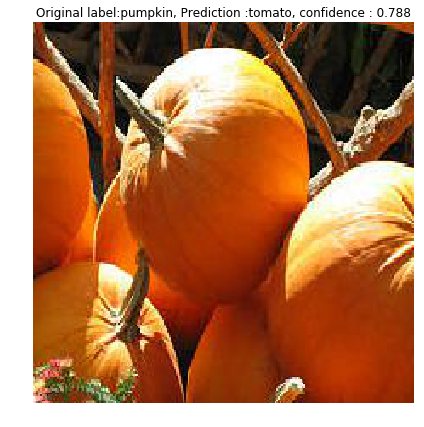

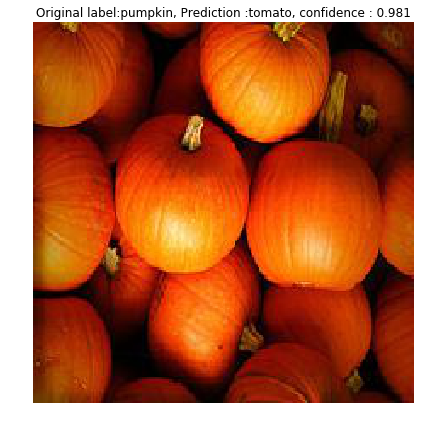

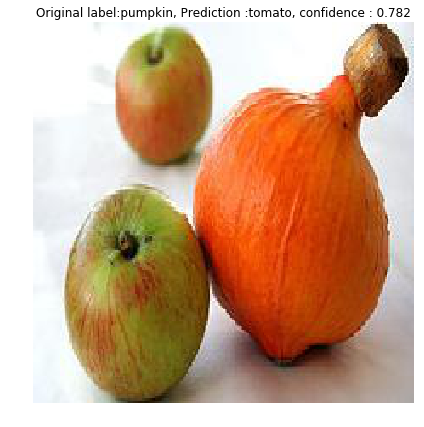

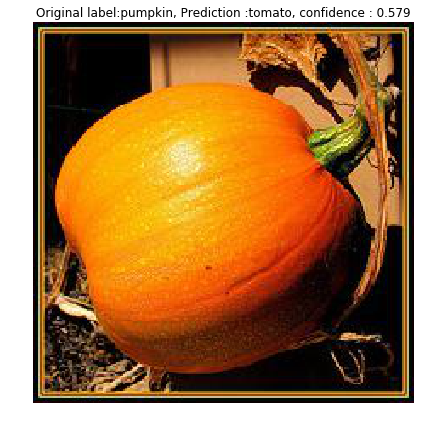

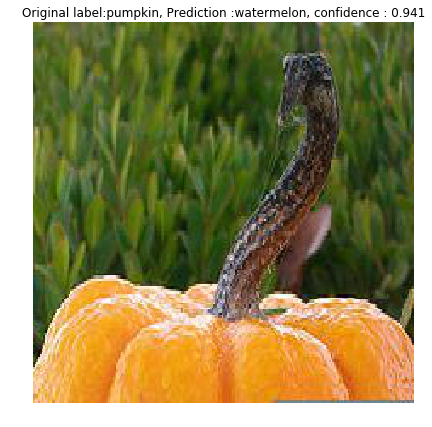

...

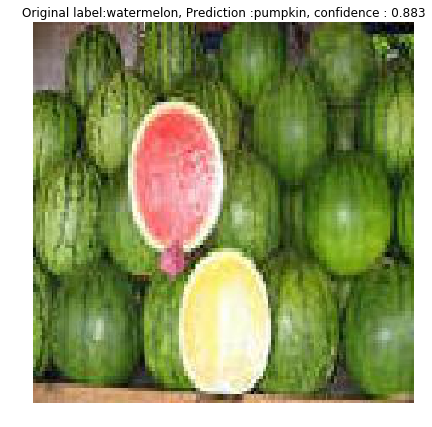

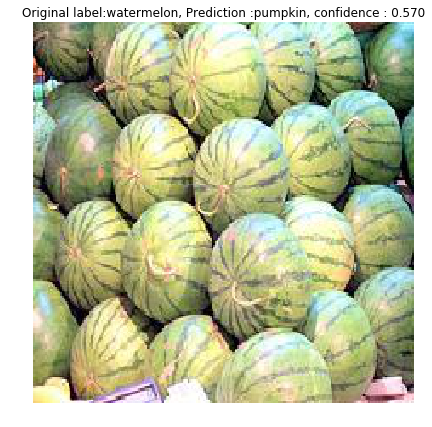

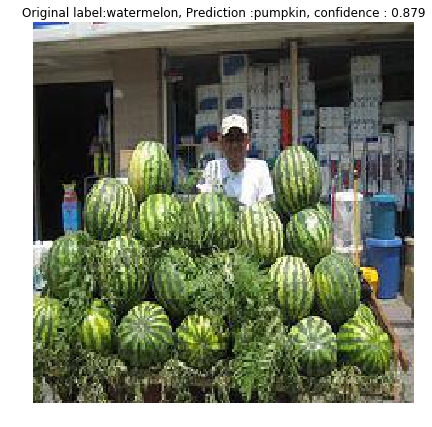

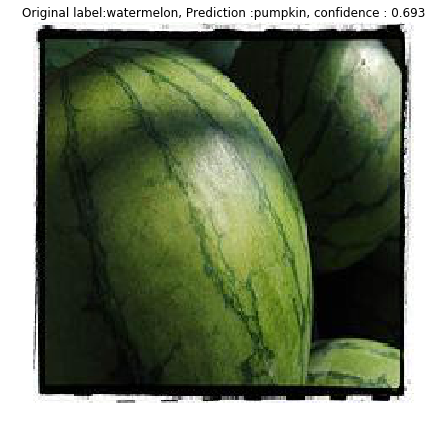

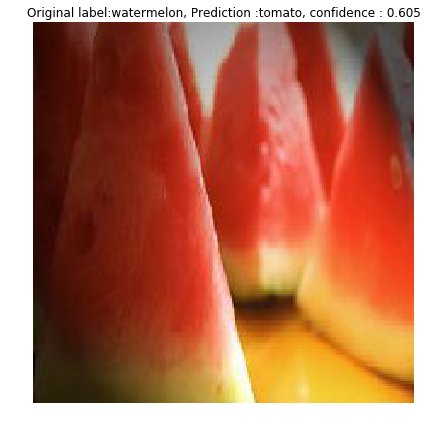

In [5]:
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

## Experiment 2 : Train Last 4 layers without data augmentation

In [9]:
from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:-1]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(256 , activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(10 , activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.topology.InputLayer object at 0x7f61be311668> False
<keras.layers.convolutional.Conv2D object at 0x7f61be311588> False
<keras.layers.convolutional.Conv2D object at 0x7f61be3115c0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f61b85ae860> False
<keras.layers.convolutional.Conv2D object at 0x7f61b85b7278> False
<keras.layers.convolutional.Conv2D object at 0x7f61b85a39e8> False
<keras.layers.pooling.MaxPooling2D object at 0x7f61bdd68080> False
<keras.layers.convolutional.Conv2D object at 0x7f61bdd69470> False
<keras.layers.convolutional.Conv2D object at 0x7f61bdde8d30> False
<keras.layers.convolutional.Conv2D object at 0x7f61be24e0f0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f61bdddb860> False
<keras.layers.convolutional.Conv2D object at 0x7f61be247160> False
<keras.layers.convolutional.Conv2D object at 0x7f61b84c24e0> False
<keras.layers.convolutional.Conv2D object at 0x7f61b84d0be0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f61b84e4240> Fa

## Experiment 2
Train the model

In [10]:
# No Data augmentation 
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
history = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('last4_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Found 15264 images belonging to 10 classes.
Found 1245 images belonging to 10 classes.
Epoch 1/20
 39/152 [======>.......................] - ETA: 53s - loss: 1.8418 - acc: 0.3933

KeyboardInterrupt: 

## Experiment 2
Show the errors

Found 1245 images belonging to 10 classes.
125/124 [==============================] - 6s 52ms/step
No of errors = 414/1245


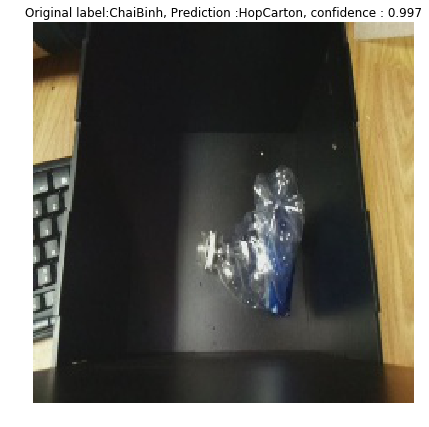

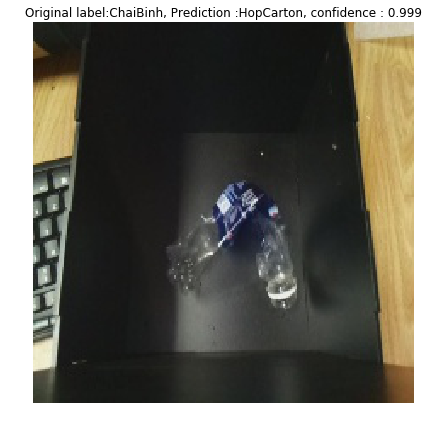

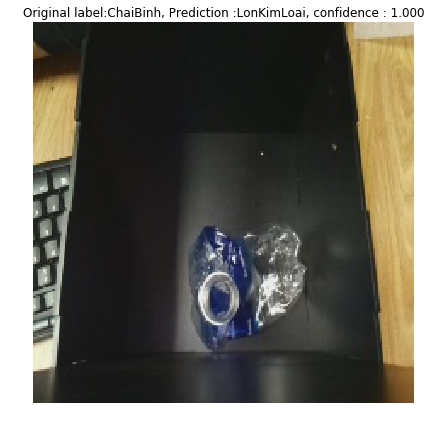

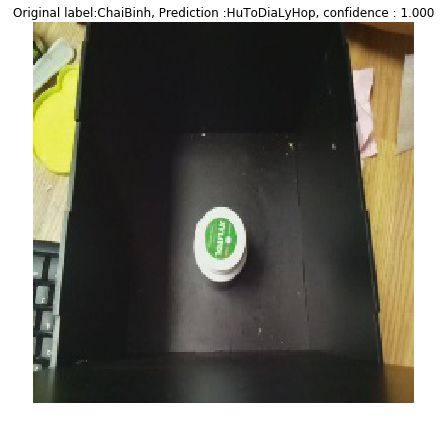

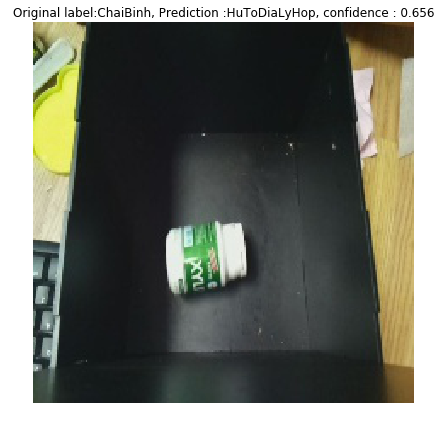

...

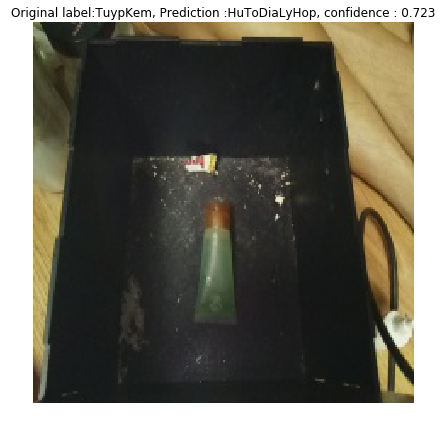

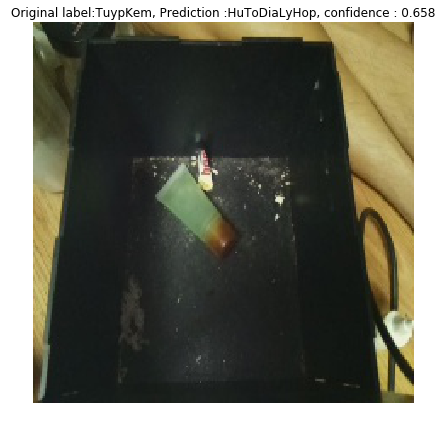

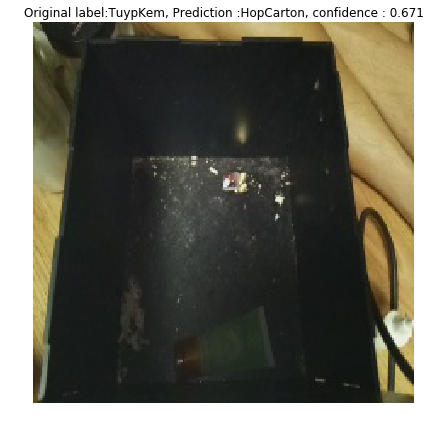

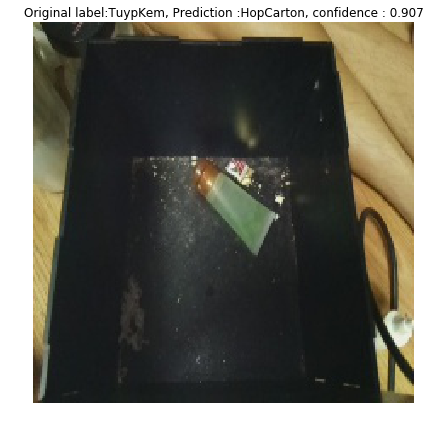

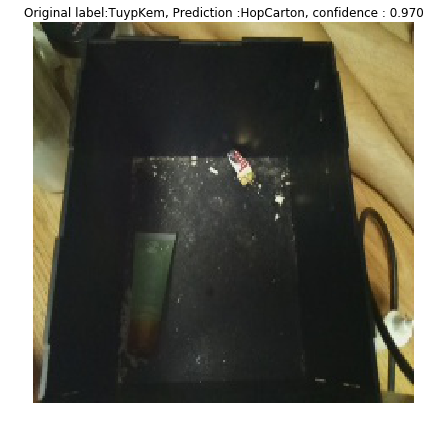

In [7]:
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

## Experiment 3 : Train last 4 layers with data augmentation


In [13]:
from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
#model.add(layers.Dense(256 , activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(10 , activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.topology.InputLayer object at 0x7f61be6d3710> False
<keras.layers.convolutional.Conv2D object at 0x7f5f5c196358> False
<keras.layers.convolutional.Conv2D object at 0x7f61ac1329e8> False
<keras.layers.pooling.MaxPooling2D object at 0x7f5f5c288550> False
<keras.layers.convolutional.Conv2D object at 0x7f5f5c2f35c0> False
<keras.layers.convolutional.Conv2D object at 0x7f61c12ddbe0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f6207319208> False
<keras.layers.convolutional.Conv2D object at 0x7f61c1723898> False
<keras.layers.convolutional.Conv2D object at 0x7f61c172f748> False
<keras.layers.convolutional.Conv2D object at 0x7f5f246cae80> False
<keras.layers.pooling.MaxPooling2D object at 0x7f61be7463c8> False
<keras.layers.convolutional.Conv2D object at 0x7f61be1d9240> False
<keras.layers.convolutional.Conv2D object at 0x7f61be1f3eb8> False
<keras.layers.convolutional.Conv2D object at 0x7f61bfacac88> False
<keras.layers.pooling.MaxPooling2D object at 0x7f5f246d46a0> Fa

## Experiment 3
Train the model. Here we will be using the imageDataGenerator for data augmentation.

In [22]:
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=20,
      width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 50
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
# NOTE that we have multiplied the steps_per_epoch by 2. This is because we are using data augmentation.
history = model.fit_generator(
      train_generator,
      steps_per_epoch=2*train_generator.samples/train_generator.batch_size ,
      epochs=40,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('da_last4_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Found 13869 images belonging to 10 classes.
Found 1157 images belonging to 10 classes.
Epoch 1/40
 76/554 [===>..........................] - ETA: 4:01 - loss: 0.8561 - acc: 0.7295

StopIteration: cannot identify image file './clean-dataset/train/GiayBaoTapChi/._20171222145844413.jpg'

In [21]:
model.layers[-2].trainable = True 
# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4 ),
              metrics=['acc'])

# Train the Model
# NOTE that we have multiplied the steps_per_epoch by 2. This is because we are using data augmentation.
history = model.fit_generator(
      train_generator,
      steps_per_epoch=2*train_generator.samples/train_generator.batch_size ,
      epochs=10,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

Epoch 1/10
611/610 [==============================] - 296s 485ms/step - loss: 0.9088 - acc: 0.7092 - val_loss: 1.0741 - val_acc: 0.6691
Epoch 2/10
611/610 [==============================] - 316s 517ms/step - loss: 0.9009 - acc: 0.7103 - val_loss: 1.0998 - val_acc: 0.6699
Epoch 3/10
611/610 [==============================] - 322s 526ms/step - loss: 0.8871 - acc: 0.7173 - val_loss: 1.0831 - val_acc: 0.6699
Epoch 4/10
611/610 [==============================] - 315s 515ms/step - loss: 0.8772 - acc: 0.7196 - val_loss: 1.1353 - val_acc: 0.6474
Epoch 5/10
611/610 [==============================] - 312s 510ms/step - loss: 0.8616 - acc: 0.7210 - val_loss: 1.0917 - val_acc: 0.6723
Epoch 6/10
611/610 [==============================] - 292s 477ms/step - loss: 0.8570 - acc: 0.7284 - val_loss: 1.0660 - val_acc: 0.6699
Epoch 7/10
611/610 [==============================] - 292s 477ms/step - loss: 0.8531 - acc: 0.7256 - val_loss: 1.0727 - val_acc: 0.6643
Epoch 8/10
611/610 [============================

KeyboardInterrupt: 

In [20]:
for layer in model.layers:
    print(layer, layer.trainable)
model.summary()

<keras.engine.training.Model object at 0x7f61be790630> True
<keras.layers.core.Flatten object at 0x7f5f2461efd0> True
<keras.layers.core.Dropout object at 0x7f5f245c7a20> True
<keras.layers.core.Dense object at 0x7f5f24656cc0> True
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_7 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_13 (Dense)             (None, 10)                250890    
Total params: 14,965,578
Trainable params: 250,890
Non-trainable params: 14,714,688
_________________________________________________________________


## Experiment 3
Show the errors

Found 150 images belonging to 3 classes.
15/15 [==============================] - 0s     
No of errors = 3/150


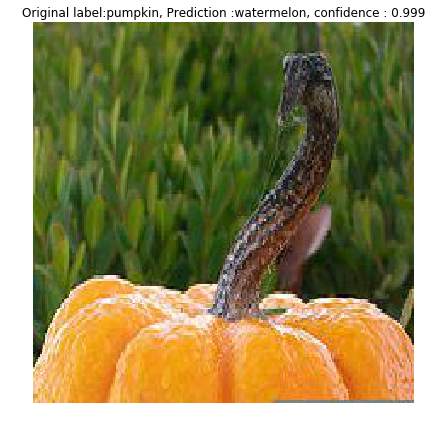

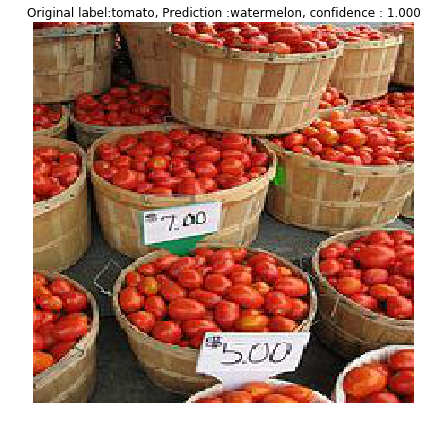

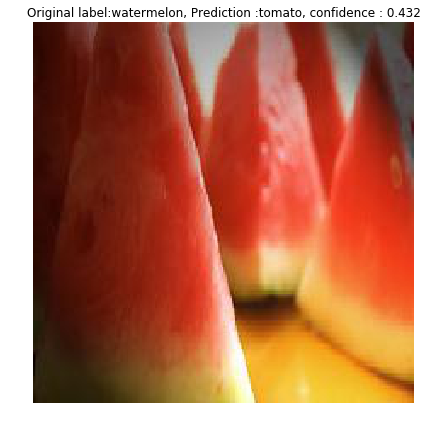

In [14]:
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()